<div class="list-group" id="list-tab" role="tablist">
  <h3 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">Index</h3>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#🚀-Environment-Setting" role="tab" aria-controls="profile">🚀 Environment Setting<span class="badge badge-primary badge-pill">1</span></a>
  <a class="list-group-item list-group-item-action" data-toggle="list" href="#🚀-Helper-functions" role="tab" aria-controls="messages">🚀 Helper functions<span class="badge badge-primary badge-pill">2</span></a>
  <a class="list-group-item list-group-item-action"  data-toggle="list" href="#🚀-EDA-(Exploratory-Data-Analysis)" role="tab" aria-controls="settings">🚀EDA (Exploratory Data Analysis)<span class="badge badge-primary badge-pill">3</span></a>


# 🚀 Environment Setting

In [18]:
import os
import pandas as pd
import numpy as np
import cv2
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import seaborn as sns
import plotly

In [2]:
import warnings
warnings.filterwarnings("ignore")

🚀 SNAKE_CASE is used for creating variable and method names.

In [3]:
ENV_DIR = '/Users/lihongxuan/Desktop/Kaggle/NFL' # snake_case
DATA_DIR = f'{ENV_DIR}/nfl-player-contact-detection'

In [4]:
import os 
os.listdir(DATA_DIR)

['train_player_tracking.csv',
 'train_labels.csv',
 '.DS_Store',
 'test',
 'test_video_metadata.csv',
 'test_baseline_helmets.csv',
 'test_player_tracking.csv',
 'train_video_metadata.csv',
 'train_baseline_helmets.csv',
 'train',
 'sample_submission.csv']

### 🚀 Define a data parser to parse the date column
```python
from datetime import datetime

dateparse = lambda x: datetime.strptime(x, '%Y-%m-%d %H:%M:%S')

df = pd.read_csv(infile, parse_dates=['datetime'], date_parser=dateparse)
```


### 🚀 f-string repalce .format
f"This is an f-string {var_name} and {var_name}."

In [50]:
# Training data
# -----------------------------------------------------------------------

# Bounding Box
train_df = pd.read_csv(f'{DATA_DIR}/train_labels.csv', parse_dates=["datetime"])

# Tracking Information using Sensor
train_tracking_df = pd.read_csv(f'{DATA_DIR}/train_player_tracking.csv', parse_dates=["datetime"]) 
test_tracking_df = pd.read_csv(f'{DATA_DIR}/test_player_tracking.csv', parse_dates=["datetime"])

# Video metadata
train_metadata_df = pd.read_csv(f'{DATA_DIR}/train_video_metadata.csv', parse_dates=["start_time", "end_time", "snap_time"])
test_metadata_df = pd.read_csv(f'{DATA_DIR}/test_video_metadata.csv', parse_dates=["start_time", "end_time", "snap_time"])

# Baseline Prediction - Trained by images inside folder images/
train_predict_df = pd.read_csv(f'{DATA_DIR}/train_baseline_helmets.csv')
test_predict_df = pd.read_csv(f'{DATA_DIR}/test_baseline_helmets.csv')

In [9]:
train_metadata_df

,game_play,game_key,play_id,view,start_time,end_time,snap_time
0,58168_003392,58168,3392,Endzone,2020-09-11 03:01:43.134000+00:00,2020-09-11 03:01:54.971000+00:00,2020-09-11 03:01:48.134000+00:00
1,58168_003392,58168,3392,Sideline,2020-09-11 03:01:43.134000+00:00,2020-09-11 03:01:54.971000+00:00,2020-09-11 03:01:48.134000+00:00
2,58172_003247,58172,3247,Endzone,2020-09-13 19:30:42.414000+00:00,2020-09-13 19:31:00.524000+00:00,2020-09-13 19:30:47.414000+00:00
3,58172_003247,58172,3247,Sideline,2020-09-13 19:30:42.414000+00:00,2020-09-13 19:31:00.524000+00:00,2020-09-13 19:30:47.414000+00:00
4,58173_003606,58173,3606,Endzone,2020-09-13 19:45:07.527000+00:00,2020-09-13 19:45:26.438000+00:00,2020-09-13 19:45:12.527000+00:00
...,...,...,...,...,...,...,...
475,58580_003294,58580,3294,Sideline,2021-10-10 22:49:20.085000+00:00,2021-10-10 22:49:33.891000+00:00,2021-10-10 22:49:25.085000+00:00
476,58581_000040,58581,40,Endzone,2021-10-11 00:22:39.997000+00:00,2021-10-11 00:22:52.068000+00:00,2021-10-11 00:22:44.997000+00:00
477,58581_000040,58581,40,Sideline,2021-10-11 00:22:39.997000+00:00,2021-10-11 00:22:52.068000+00:00,2021-10-11 00:22:44.997000+00:00
478,58582_003121,58582,3121,Endzone,2021-10-12 02:42:15.078000+00:00,2021-10-12 02:42:29.118000+00:00,2021-10-12 02:42:20.078000+00:00


In [14]:
import pandas as pd
train_df = pd.read_csv(f'{DATA_DIR}/train_labels.csv', parse_dates=["datetime"])
train_df

,contact_id,game_play,datetime,step,nfl_player_id_1,nfl_player_id_2,contact
0,58168_003392_0_38590_43854,58168_003392,2020-09-11 03:01:48.100000+00:00,0,38590,43854,0
1,58168_003392_0_38590_41257,58168_003392,2020-09-11 03:01:48.100000+00:00,0,38590,41257,0
2,58168_003392_0_38590_41944,58168_003392,2020-09-11 03:01:48.100000+00:00,0,38590,41944,0
3,58168_003392_0_38590_42386,58168_003392,2020-09-11 03:01:48.100000+00:00,0,38590,42386,0
4,58168_003392_0_38590_47944,58168_003392,2020-09-11 03:01:48.100000+00:00,0,38590,47944,0
...,...,...,...,...,...,...,...
4721613,58582_003121_91_48220_G,58582_003121,2021-10-12 02:42:29.100000+00:00,91,48220,G,0
4721614,58582_003121_91_47906_G,58582_003121,2021-10-12 02:42:29.100000+00:00,91,47906,G,0
4721615,58582_003121_91_38557_G,58582_003121,2021-10-12 02:42:29.100000+00:00,91,38557,G,0
4721616,58582_003121_91_47872_G,58582_003121,2021-10-12 02:42:29.100000+00:00,91,47872,G,0


### 🚀 Get Image from video

Code is based on https://www.kaggle.com/coldfir3/eda-helmet-keypoint-tracking-data-comparison

In [17]:
# reference : https://www.kaggle.com/coldfir3/eda-helmet-keypoint-tracking-data-comparison
def get_frame_from_video(video_path, frame):
    video_path = f"{DATA_DIR}/train/{video_path}"
    frame = frame - 1

    !ffmpeg \
        -hide_banner \
        -loglevel fatal \
        -nostats \
        -i $video_path -vf "select=eq(n\,$frame)" \
        -vframes 1 \
        frame.png
    img = Image.open('frame.png')
    return img

In [16]:
get_frame_from_video('58168_003392_Sideline.mp4', 520)

zsh:1: command not found: ffmpeg


NameError: name 'img' is not defined

### 🚀Draw Bounding Box
1. DataFrame.iterrows is a generator which yields both the index and row (as a Series)

2. ImageDraw.Draw module provide simple 2D graphics for Image objects.

3. \<string\>.split(sep) /  \<sep\>.join(\<iterable\>)


In [20]:
import pandas as pd

df = pd.DataFrame({'c1': [10, 11, 12], 'c2': [100, 110, 120]})
df = df.reset_index()  # make sure indexes pair with number of rows

for index, row in df.iterrows():
    print(row['c1'], row['c2'])

10 100
11 110
12 120


In [8]:
def draw_rect(image, bbox_df):
    new_image = image.copy()
    draw = ImageDraw.Draw(new_image)
    for _, (left, width, top, height) in bbox_df[['left', 'width', 'top', 'height']].iterrows():
        draw.rectangle(((left, top), (left + width, top + height)), outline=(0, 255, 0), width=2)
    return new_image

In [9]:
def frame_bbox(df, video_frame):
    video_name = '_'.join(video_frame.split('_')[:3]) + '.mp4'
    frame = int(video_frame.split('_')[-1])
    
    image = get_frame_from_video(video_name, frame)
    bbox_df = df.query('video == @video_name and frame == @frame')
    
    bbox_image = draw_rect(image, bbox_df)
    
    return bbox_image

In [ ]:
frame_bbox(train_predict_df, '58168_003392_Endzone_290')

### 🚀 Video Play in Notebook
from IPython.display import Video

In [21]:
from IPython.display import Video, display

def video(video_path, ratio=0.7):
    nfl_video = Video(f"{DATA_DIR}/train/{video_path}",
                      embed=True,
                      height=int(720 * ratio),
                      width=int(1280 * ratio))
    return nfl_video
    
video('58168_003392_Endzone.mp4')

## Football Animation

> football animation made by `ammarnassanalhajali`

**Reference**
- https://www.kaggle.com/ammarnassanalhajali/nfl-big-data-bowl-2021-animating-players
- https://www.kaggle.com/robikscube/nfl-helmet-assignment-getting-started-guide

In [22]:
import plotly.express as px
import plotly.graph_objects as go
import plotly


def add_plotly_field(fig):
    # Reference https://www.kaggle.com/ammarnassanalhajali/nfl-big-data-bowl-2021-animating-players
    fig.update_traces(marker_size=20)
    
    fig.update_layout(paper_bgcolor='#29a500', plot_bgcolor='#29a500', font_color='white',
        width = 800,
        height = 600,
        title = "",
        
        xaxis = dict(
        nticks = 10,
        title = "",
        visible=False
        ),
        
        yaxis = dict(
        scaleanchor = "x",
        title = "Temp",
        visible=False
        ),
        showlegend= True,
  
        annotations=[
       dict(
            x=-5,
            y=26.65,
            xref="x",
            yref="y",
            text="ENDZONE",
            font=dict(size=16,color="#e9ece7"),
            align='center',
            showarrow=False,
            yanchor='middle',
            textangle=-90
        ),
        dict(
            x=105,
            y=26.65,
            xref="x",
            yref="y",
            text="ENDZONE",
            font=dict(size=16,color="#e9ece7"),
            align='center',
            showarrow=False,
            yanchor='middle',
            textangle=90
        )]  
        ,
        legend=dict(
        traceorder="normal",
        font=dict(family="sans-serif",size=12),
        title = "",
        orientation="h",
        yanchor="bottom",
        y=1.00,
        xanchor="center",
        x=0.5
        ),
    )
    ####################################################
        
    fig.add_shape(type="rect", x0=-10, x1=0,  y0=0, y1=53.3,line=dict(color="#c8ddc0",width=3),fillcolor="#217b00" ,layer="below")
    fig.add_shape(type="rect", x0=100, x1=110, y0=0, y1=53.3,line=dict(color="#c8ddc0",width=3),fillcolor="#217b00" ,layer="below")
    for x in range(0, 100, 10):
        fig.add_shape(type="rect", x0=x,   x1=x+10, y0=0, y1=53.3,line=dict(color="#c8ddc0",width=3),fillcolor="#29a500" ,layer="below")
    for x in range(0, 100, 1):
        fig.add_shape(type="line",x0=x, y0=1, x1=x, y1=2,line=dict(color="#c8ddc0",width=2),layer="below")
    for x in range(0, 100, 1):
        fig.add_shape(type="line",x0=x, y0=51.3, x1=x, y1=52.3,line=dict(color="#c8ddc0",width=2),layer="below")
    
    for x in range(0, 100, 1):
        fig.add_shape(type="line",x0=x, y0=20.0, x1=x, y1=21,line=dict(color="#c8ddc0",width=2),layer="below")
    for x in range(0, 100, 1):
        fig.add_shape(type="line",x0=x, y0=32.3, x1=x, y1=33.3,line=dict(color="#c8ddc0",width=2),layer="below")
    
    
    fig.add_trace(go.Scatter(
    x=[2,10,20,30,40,50,60,70,80,90,98], y=[5,5,5,5,5,5,5,5,5,5,5],
    text=["G","1 0","2 0","3 0","4 0","5 0","4 0","3 0","2 0","1 0","G"],
    mode="text",
    textfont=dict(size=20,family="Arail"),
    showlegend=False,
    ))
    
    fig.add_trace(go.Scatter(
    x=[2,10,20,30,40,50,60,70,80,90,98], y=[48.3,48.3,48.3,48.3,48.3,48.3,48.3,48.3,48.3,48.3,48.3],
    text=["G","1 0","2 0","3 0","4 0","5 0","4 0","3 0","2 0","1 0","G"],
    mode="text",
    textfont=dict(size=20,family="Arail"),
    showlegend=False,
    ))
    
    return fig

In [31]:
train_tracking_df

,game_play,game_key,play_id,nfl_player_id,datetime,step,team,position,jersey_number,x_position,y_position,speed,distance,direction,orientation,acceleration,sa
0,58580_001136,58580,1136,44830,2021-10-10 21:08:20.900000+00:00,-108,away,CB,22,61.59,42.60,1.11,0.11,320.33,263.93,0.71,-0.64
1,58580_001136,58580,1136,47800,2021-10-10 21:08:20.900000+00:00,-108,away,DE,97,59.48,26.81,0.23,0.01,346.84,247.16,1.29,0.90
2,58580_001136,58580,1136,52444,2021-10-10 21:08:20.900000+00:00,-108,away,FS,29,72.19,31.46,0.61,0.06,11.77,247.69,0.63,-0.33
3,58580_001136,58580,1136,46206,2021-10-10 21:08:20.900000+00:00,-108,home,TE,86,57.37,22.12,0.37,0.04,127.85,63.63,0.69,0.62
4,58580_001136,58580,1136,52663,2021-10-10 21:08:20.900000+00:00,-108,away,ILB,48,63.25,27.50,0.51,0.05,183.62,253.71,0.31,0.31
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1353048,58575_003081,58575,3081,48476,2021-10-10 19:22:06.800000+00:00,140,away,CB,40,72.28,51.80,1.59,0.17,345.36,342.68,0.49,-0.41
1353049,58575_003081,58575,3081,44887,2021-10-10 19:22:06.800000+00:00,140,away,ILB,45,74.76,54.50,0.98,0.10,342.39,354.46,0.63,-0.24
1353050,58575_003081,58575,3081,44174,2021-10-10 19:22:06.800000+00:00,140,away,ILB,49,74.54,55.75,1.12,0.11,352.79,349.20,0.63,0.46
1353051,58575_003081,58575,3081,45217,2021-10-10 19:22:06.800000+00:00,140,away,TE,82,80.44,48.77,1.93,0.20,340.78,346.51,0.53,-0.51


### 🚀 rank 函数返回从小到大排序的下标
method = 'average'，'first'，'min'， 'max'，'dense'

first: 出现的位置靠前 排名靠前

min: 取最小排名

max: 取最大排名

dense: 相同值排名相同，其他依次+1

In [41]:

df = pd.DataFrame({'team': ['A', 'A', 'A', 'A', 'B', 'B', 'C', 'C', 'C'],
                   'points': [10, 10, 12, 15, 19, 23, 20, 20, 26]})
df['points_rank'] = df.groupby(['team'])['points'].rank('dense', ascending=False).astype("int")

#view updated DataFrame
print(df)

  team  points  points_rank
0    A      10            3
1    A      10            3
2    A      12            2
3    A      15            1
4    B      19            2
5    B      23            1
6    C      20            2
7    C      20            2
8    C      26            1


### 🚀 按照play分组进行帧排序

In [51]:


train_tracking_df["track_time_count"] = (
    train_tracking_df.sort_values("datetime")
    .groupby("game_play")["datetime"]
    .rank(method="dense")
    .astype("int")
)

train_tracking_df

,game_play,game_key,play_id,nfl_player_id,datetime,step,team,position,jersey_number,x_position,y_position,speed,distance,direction,orientation,acceleration,sa,track_time_count
0,58580_001136,58580,1136,44830,2021-10-10 21:08:20.900000+00:00,-108,away,CB,22,61.59,42.60,1.11,0.11,320.33,263.93,0.71,-0.64,1
1,58580_001136,58580,1136,47800,2021-10-10 21:08:20.900000+00:00,-108,away,DE,97,59.48,26.81,0.23,0.01,346.84,247.16,1.29,0.90,1
2,58580_001136,58580,1136,52444,2021-10-10 21:08:20.900000+00:00,-108,away,FS,29,72.19,31.46,0.61,0.06,11.77,247.69,0.63,-0.33,1
3,58580_001136,58580,1136,46206,2021-10-10 21:08:20.900000+00:00,-108,home,TE,86,57.37,22.12,0.37,0.04,127.85,63.63,0.69,0.62,1
4,58580_001136,58580,1136,52663,2021-10-10 21:08:20.900000+00:00,-108,away,ILB,48,63.25,27.50,0.51,0.05,183.62,253.71,0.31,0.31,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1353048,58575_003081,58575,3081,48476,2021-10-10 19:22:06.800000+00:00,140,away,CB,40,72.28,51.80,1.59,0.17,345.36,342.68,0.49,-0.41,259
1353049,58575_003081,58575,3081,44887,2021-10-10 19:22:06.800000+00:00,140,away,ILB,45,74.76,54.50,0.98,0.10,342.39,354.46,0.63,-0.24,259
1353050,58575_003081,58575,3081,44174,2021-10-10 19:22:06.800000+00:00,140,away,ILB,49,74.54,55.75,1.12,0.11,352.79,349.20,0.63,0.46,259
1353051,58575_003081,58575,3081,45217,2021-10-10 19:22:06.800000+00:00,140,away,TE,82,80.44,48.77,1.93,0.20,340.78,346.51,0.53,-0.51,259


### 🚀reset_index is the reverse of set_index
When we reset the index, the old index is added as a column, and a new sequential index is used.
drop = True will delete the index

In [49]:
game_play = "58580_001136"
train_tracking_df["player"] = train_tracking_df["team"].str.upper().str[0] + train_tracking_df["jersey_number"].astype("str")
train_tracking_df.query("game_play == @game_play").groupby(["track_time_count"]).apply(lambda x: x.sort_values(["player"], ascending = False)).reset_index(drop=True)

,game_play,game_key,play_id,nfl_player_id,datetime,step,team,position,jersey_number,x_position,y_position,speed,distance,direction,orientation,acceleration,sa,track_time_count,player
0,58580_001136,58580,1136,45532,2021-10-10 21:08:20.900000+00:00,-108,home,TE,89,57.16,30.99,0.07,0.01,39.61,100.73,0.51,-0.14,1,H89
1,58580_001136,58580,1136,52425,2021-10-10 21:08:20.900000+00:00,-108,home,WR,88,56.59,42.86,0.13,0.01,158.78,98.31,0.32,0.02,1,H88
2,58580_001136,58580,1136,46206,2021-10-10 21:08:20.900000+00:00,-108,home,TE,86,57.37,22.12,0.37,0.04,127.85,63.63,0.69,0.62,1,H86
3,58580_001136,58580,1136,52938,2021-10-10 21:08:20.900000+00:00,-108,home,T,78,57.27,23.47,0.19,0.02,356.50,87.29,0.10,-0.10,1,H78
4,58580_001136,58580,1136,37082,2021-10-10 21:08:20.900000+00:00,-108,home,T,77,57.16,29.54,0.12,0.01,145.27,85.16,0.07,0.01,1,H77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3977,58580_001136,58580,1136,52663,2021-10-10 21:08:38.900000+00:00,72,away,ILB,48,59.44,38.51,1.03,0.11,147.36,149.83,0.84,0.09,181,A48
3978,58580_001136,58580,1136,52444,2021-10-10 21:08:38.900000+00:00,72,away,FS,29,64.67,34.45,1.02,0.10,225.50,246.35,0.54,-0.10,181,A29
3979,58580_001136,58580,1136,43351,2021-10-10 21:08:38.900000+00:00,72,away,CB,24,66.50,24.03,1.23,0.12,286.19,279.63,0.19,-0.03,181,A24
3980,58580_001136,58580,1136,40031,2021-10-10 21:08:38.900000+00:00,72,away,FS,23,59.43,34.65,1.58,0.16,155.00,146.68,0.63,0.14,181,A23


In [52]:
def football_animation(game_play):
    train_tracking_df["player"] = train_tracking_df["team"].str.upper().str[0] + train_tracking_df["jersey_number"].astype("str")
   
    train_tracking_df["track_time_count"] = (
        train_tracking_df.sort_values("datetime")
        .groupby("game_play")["datetime"]
        .rank(method="dense")
        .astype("int")
    )
    
    
    fig = px.scatter(
        train_tracking_df.query("game_play == @game_play")
        .groupby(["track_time_count"])
        .apply(lambda x: x.sort_values(["player"], ascending = False))
        .reset_index(drop=True),# sort player number within the same tracking count (plotly scatter animation requirement),
        
        x="x_position",
        y="y_position",
        range_x=[-10, 110],
        range_y=[-10, 53.3],
        hover_data=["player", "speed", "acceleration", "direction"],
        color="team",
        animation_frame="track_time_count",
        text="player",
        title=f"Animation of NGS data for game_play {game_play}",
    )

    fig.update_traces(textfont_size=10)
    fig = add_plotly_field(fig)
    fig.show()

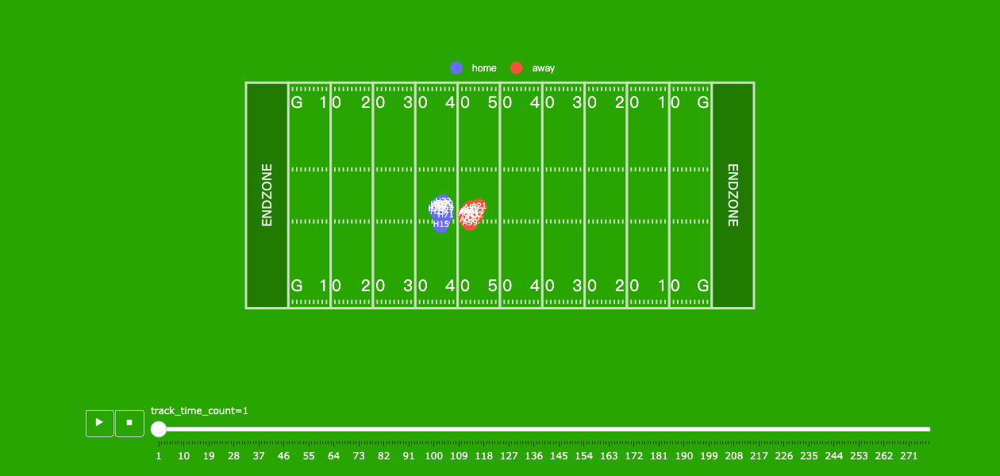

In [53]:
football_animation('58168_003392')

### 🚀os.listdir() 方法用于返回指定的文件夹包含的文件或文件夹的名字的列表

In [13]:
train_videos = os.listdir(f'{DATA_DIR}/train')
test_videos = os.listdir(f'{DATA_DIR}/test')
len(train_videos), len(test_videos)

(720, 6)

### 🚀 applying funtion to group (modify DataFrame)

.to_frame() convert Series to DataFrame

In [55]:
def get_total_frame(video_path):
    cap = cv2.VideoCapture(f"{DATA_DIR}/train/{video_path}")
    property_id = int(cv2.CAP_PROP_FRAME_COUNT) 
    length = int(cv2.VideoCapture.get(cap, property_id))
    return length
def add_view(group): # add all29 view to meta data dataframe
    first_row = group.iloc[[0]]
    first_row.iloc[:,1:] = np.nan
    first_row['view'] = "All29"
    return first_row.append(group)

In [14]:
train_metadata_df

,game_play,game_key,play_id,view,start_time,end_time,snap_time
0,58168_003392,58168,3392,Endzone,2020-09-11 03:01:43.134000+00:00,2020-09-11 03:01:54.971000+00:00,2020-09-11 03:01:48.134000+00:00
1,58168_003392,58168,3392,Sideline,2020-09-11 03:01:43.134000+00:00,2020-09-11 03:01:54.971000+00:00,2020-09-11 03:01:48.134000+00:00
2,58172_003247,58172,3247,Endzone,2020-09-13 19:30:42.414000+00:00,2020-09-13 19:31:00.524000+00:00,2020-09-13 19:30:47.414000+00:00
3,58172_003247,58172,3247,Sideline,2020-09-13 19:30:42.414000+00:00,2020-09-13 19:31:00.524000+00:00,2020-09-13 19:30:47.414000+00:00
4,58173_003606,58173,3606,Endzone,2020-09-13 19:45:07.527000+00:00,2020-09-13 19:45:26.438000+00:00,2020-09-13 19:45:12.527000+00:00
...,...,...,...,...,...,...,...
475,58580_003294,58580,3294,Sideline,2021-10-10 22:49:20.085000+00:00,2021-10-10 22:49:33.891000+00:00,2021-10-10 22:49:25.085000+00:00
476,58581_000040,58581,40,Endzone,2021-10-11 00:22:39.997000+00:00,2021-10-11 00:22:52.068000+00:00,2021-10-11 00:22:44.997000+00:00
477,58581_000040,58581,40,Sideline,2021-10-11 00:22:39.997000+00:00,2021-10-11 00:22:52.068000+00:00,2021-10-11 00:22:44.997000+00:00
478,58582_003121,58582,3121,Endzone,2021-10-12 02:42:15.078000+00:00,2021-10-12 02:42:29.118000+00:00,2021-10-12 02:42:20.078000+00:00


In [75]:
train_metadata_all_df = train_metadata_df.groupby("game_play").apply(add_view).reset_index(drop=True)
train_video = (train_metadata_all_df.game_play + "_" + train_metadata_all_df.view + ".mp4").to_frame()
train_video.columns = ["video_name"]
train_video["frames"] = train_video["video_name"].apply(get_total_frame)

In [73]:
train_video

,0
0,58168_003392_All29.mp4
1,58168_003392_Endzone.mp4
2,58168_003392_Sideline.mp4
3,58172_003247_All29.mp4
4,58172_003247_Endzone.mp4
...,...
715,58581_000040_Endzone.mp4
716,58581_000040_Sideline.mp4
717,58582_003121_All29.mp4
718,58582_003121_Endzone.mp4


<AxesSubplot:xlabel='frames', ylabel='Count'>

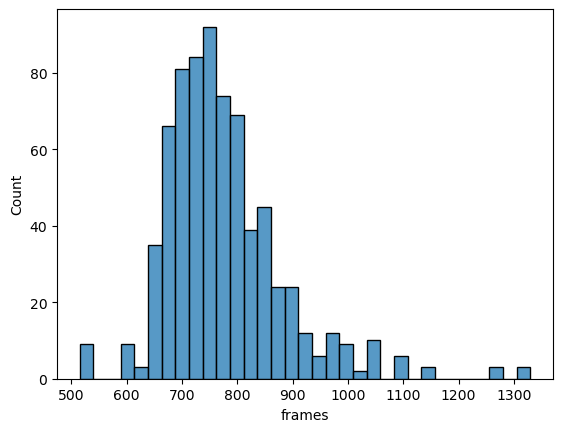

In [76]:
sns.histplot(train_video.frames) 

In [77]:
train_video.frames.sum()

559015

## Does Sideline, Endzone Video and All29 has same frame?
> 11 game plays out of 240 doesn't match and the minimum difference is 1 and the maximum difference is 24

In [78]:
train_metadata_df.view.value_counts()

Endzone     240
Sideline    240
Name: view, dtype: int64

In [ ]:
not_match_video = []
no_match = 0

train_video["game_play"] = train_metadata_all_df.game_play
train_video["view"] = train_metadata_all_df.view

for play in train_predict_df.game_play.unique():
    end_frame_n = train_video.query('game_play == @play and view == "Endzone"').frames.values[0]
    side_frame_n = train_video.query('game_play == @play and view == "Sideline"').frames.values[0]
    all_frame_n = train_video.query('game_play == @play and view == "All29"').frames.values[0]
    
    if end_frame_n != side_frame_n: # all29 is not guaranteed to be synced with end and side
        no_match +=1
        not_match_video.append(play)
        print(f'Not same at playID {play} endzone [{end_frame_n}] sideline [{side_frame_n}] all29 [{all_frame_n}]  difference [{abs(end_frame_n - side_frame_n)}]')
print("\n")
print(f'{no_match} of {len(train_predict_df.game_play.unique())} videos are not matched ')

### 🚀 apply unique() funtion to group object

In [79]:
train_metadata_df.game_key.nunique()

149

In [80]:
train_metadata_df.play_id.nunique()

233

In [83]:
train_metadata_df.groupby('game_key')['play_id'].unique()

game_key
58168          [3392]
58172          [3247]
58173          [3606]
58174          [1792]
58176          [2844]
             ...     
58577          [2486]
58579          [3527]
58580    [1136, 3294]
58581            [40]
58582          [3121]
Name: play_id, Length: 149, dtype: object

## How many plays per game?
- 89 games has only 1 play
- 42 games has 2 plays
- 10 game has 3 plays
- 5 game has 4 plays
- 1 game has 5 plays
- 2 game has 6 plays

In [86]:
play_per_game = train_metadata_df.groupby('game_key')['play_id'].nunique()

play_per_game.to_dict()

# .reset_index().groupby('play_id')['game_key'].unique().to_dict()
# for key,value in play_per_game.items():
#     print(f" {len(value)} games have {key} plays ")

{58168: 1,
 58172: 1,
 58173: 1,
 58174: 1,
 58176: 1,
 58177: 1,
 58180: 2,
 58187: 6,
 58188: 2,
 58189: 1,
 58190: 2,
 58198: 2,
 58200: 3,
 58202: 4,
 58203: 1,
 58204: 6,
 58205: 1,
 58209: 1,
 58211: 3,
 58213: 1,
 58215: 1,
 58216: 2,
 58217: 1,
 58218: 2,
 58219: 2,
 58220: 1,
 58221: 1,
 58224: 4,
 58225: 1,
 58226: 3,
 58227: 1,
 58233: 1,
 58240: 1,
 58241: 1,
 58245: 1,
 58247: 1,
 58251: 1,
 58254: 1,
 58255: 2,
 58257: 2,
 58260: 1,
 58261: 2,
 58266: 1,
 58267: 1,
 58270: 1,
 58273: 2,
 58274: 1,
 58279: 1,
 58281: 2,
 58282: 3,
 58284: 1,
 58285: 1,
 58290: 1,
 58291: 2,
 58293: 1,
 58295: 1,
 58297: 1,
 58301: 5,
 58302: 2,
 58306: 1,
 58308: 2,
 58311: 3,
 58314: 1,
 58316: 3,
 58321: 1,
 58325: 2,
 58326: 2,
 58327: 1,
 58329: 1,
 58330: 1,
 58331: 1,
 58332: 1,
 58336: 1,
 58341: 1,
 58346: 2,
 58348: 2,
 58354: 1,
 58362: 1,
 58366: 1,
 58368: 2,
 58377: 1,
 58382: 1,
 58384: 1,
 58387: 2,
 58399: 1,
 58401: 2,
 58403: 1,
 58406: 1,
 58407: 1,
 58414: 2,
 58415: 1,

## What is the duration of each play?
> 8.6s ~ 22s per play, mostly 12s

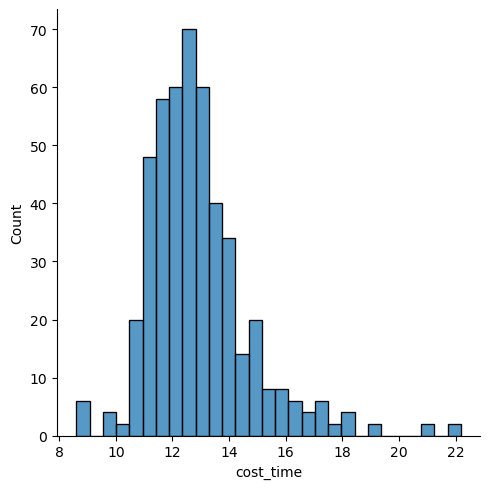

In [87]:
train_metadata_df["cost_time"] = (train_metadata_df["end_time"]-train_metadata_df["start_time"]).dt.total_seconds()
sns.displot(train_metadata_df["cost_time"])

In [ ]:
round(train_metadata_df["cost_time"] * 59.94).astype(int) #estimated frames

## Do all contacts happen after the ball snap?
> Yes, the contacts happen at or after the ball snap

<AxesSubplot:xlabel='step', ylabel='Count'>

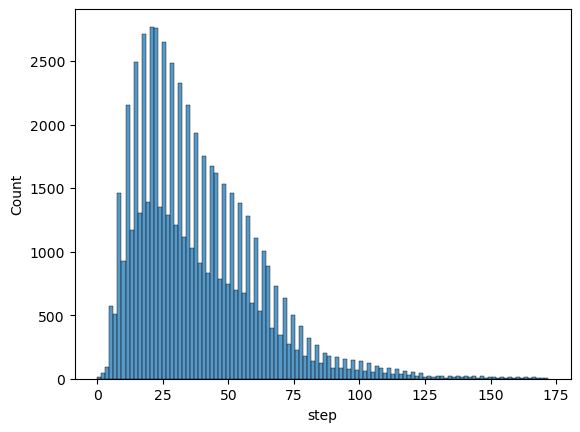

In [89]:
sns.histplot((train_df.query("contact == 1").step))

In [88]:
train_df.query("contact == 1").step.value_counts().sort_index()

0       8
1       8
2      12
3      32
4      93
       ..
168     4
169     4
170     4
171     4
172     4
Name: step, Length: 173, dtype: int64

## Does every moment have every combination of 22 players and ground?
> Yes, each play contains every contact pairs of players and ground.

### 🚀 根据多个维度分组 game_play + datetime, 并对组使用函数
使用reset_index来recover索引

In [ ]:
231+22 # combinations for 22 players and ground

In [90]:
train_df.groupby(["game_play", "datetime"]).contact_id.count().reset_index()

,game_play,datetime,contact_id
0,58168_003392,2020-09-11 03:01:48.100000+00:00,253
1,58168_003392,2020-09-11 03:01:48.200000+00:00,253
2,58168_003392,2020-09-11 03:01:48.300000+00:00,253
3,58168_003392,2020-09-11 03:01:48.400000+00:00,253
4,58168_003392,2020-09-11 03:01:48.500000+00:00,253
...,...,...,...
18663,58582_003121,2021-10-12 02:42:28.700000+00:00,253
18664,58582_003121,2021-10-12 02:42:28.800000+00:00,253
18665,58582_003121,2021-10-12 02:42:28.900000+00:00,253
18666,58582_003121,2021-10-12 02:42:29+00:00,253


### 🚀 使用query进行带条件查询

In [91]:
train_df.groupby(["game_play", "datetime"]).contact_id.count().reset_index().query("contact_id!=253").game_play.unique()

array(['58538_002774'], dtype=object)

In [92]:
# the play only has 21 players on the filed
video('58538_002774_Endzone.mp4')

### 🚀 How many players per game?
每档都要统计下，根据多个维度分组

In [94]:
# train_df.groupby(['gameKey', 'playID', 'view'])['label'].nunique().value_counts()

train_tracking_df.groupby(['game_play', 'play_id'])['nfl_player_id'].nunique().value_counts()

22    239
21      1
Name: nfl_player_id, dtype: int64

In [ ]:
train_tracking_df.query("game_play == '58580_001136'").nfl_player_id.nunique()

In [ ]:
# check what game does only 21 players are running for?
train_tracking_df.groupby(['game_play', 'play_id'])['nfl_player_id'].nunique().reset_index().query("nfl_player_id == 21")

In [ ]:
# the play which has 21 players
video('58538_002774_Endzone.mp4')

In [ ]:
football_animation('58538_002774')

## How many players exist?
> 1687 players exist in 149 games. Most games have exact 22 players in plays.
- Home and Away both have 99 numbers

In [ ]:
train_tracking_df.nfl_player_id.nunique()

In [ ]:
# examine the player number in each game
train_tracking_df.groupby("game_key").nfl_player_id.nunique().value_counts()#.sum() 149

In [ ]:
home_players = train_tracking_df.query('team == "home"').jersey_number.unique()
visitor_players = train_tracking_df.query('team == "away"').jersey_number.unique()

home_players.sort(), visitor_players.sort()
home_players, visitor_players

In [ ]:
len(home_players), len(visitor_players)

In [ ]:
set(home_players) - set(visitor_players)

## Is ball snap is the starting point of the game?
> yes! It occurs only one time per play
- Before snap players has small acceleration.
- After snap they start to run!


In [ ]:
train_tracking_df

In [ ]:
# play starting time
len(train_tracking_df[train_tracking_df.step == 0].groupby("datetime"))

In [ ]:
# Wide Recivers are fast runners

# before the ball snap the movement is Low
play = train_tracking_df.query('game_play == "58580_001136" and position == "WR"')
sns.histplot(play[play.step < 0].acceleration)

In [ ]:
# after the ball snap the movement is High
play = train_tracking_df.query('game_play == "58580_001136" and position == "WR"')
sns.histplot(play[play.step > 0].acceleration)

## Does track information always track 22 players every moment?
> No! Mostly 22 players are tracked but in one play less than 22 are tracked

In [ ]:
# Mostly 22 players are tracked but not all
train_tracking_df.groupby(['play_id', 'datetime']).count()['nfl_player_id'].value_counts()

## Why only 21 players are tracked?
> This happened in the play where only 21 players on the field

In [ ]:
player_n_df = train_tracking_df.groupby(['play_id', 'datetime']).count()['nfl_player_id'].reset_index()
player_n_df

In [ ]:
player_n_df.query('nfl_player_id == 21')

In [ ]:
player_n_df.query('nfl_player_id == 21').play_id.nunique()

In [ ]:
# There are 11 players at the last frame
train_tracking_df.query('play_id == 2774')

In [ ]:
# this is the situation where 21 player on the court
video("58538_002774_Endzone.mp4")

### 🚀 Does tracking information recorded longer than video?
求每个play的持续时间，先group play再求最大值和最小值

In [ ]:
#####
train_tracking_time = pd.concat([train_tracking_df.groupby(['game_play']).datetime.min()
                                 ,train_tracking_df.groupby(['game_play']).datetime.max()],axis = 1).reset_index()
####

train_tracking_time.columns = ["game_play","tracking_start_time", "tracking_end_time"]
train_video_time = train_metadata_df[train_metadata_df.view == "Sideline"][["game_play","start_time", "end_time", "snap_time"]].copy()

train_video_time.columns = ["game_play","video_start_time", "video_end_time", "video_snap_time"]

time_difference = pd.merge(train_tracking_time, train_video_time.iloc[:,:-1], on = "game_play")
time_difference["start_difference"] = (time_difference["tracking_start_time"]-time_difference["video_start_time"]).dt.total_seconds()
time_difference["end_difference"] = (time_difference["tracking_end_time"]-time_difference["video_end_time"]).dt.total_seconds()
time_difference["length_difference"] = (time_difference["end_difference"]-time_difference["start_difference"])

sns.histplot(time_difference.iloc[:,-3:])

## Does all trackings recorded before the ball snap?
> Yes! All plays are recorded before the ball snap!

In [ ]:
# play starts at the 5s of train_metadata_df
# every tracking starts before the play starts

time_difference["snap_offset"] = (time_difference["tracking_start_time"]-train_video_time["video_snap_time"].reset_index(drop = True)).dt.total_seconds()

len(time_difference.query("snap_offset >= 0"))

## Do plays have consistent player numbers while beeing tracked?
> Yes! The plays have consistent player numbers

In [ ]:
player_df = train_tracking_df.groupby(['game_play', 'datetime']).count().nfl_player_id.reset_index()
player_df

In [ ]:
train_tracking_df.groupby(['game_play', 'datetime']).count().nfl_player_id.value_counts()

In [ ]:
# This is the exact play 58538_002774 where only 21 players on the ground
player_df.query("nfl_player_id == 21").game_play.unique()


In [ ]:
history_df = player_df.groupby('game_play').apply(lambda x: x['nfl_player_id'].values).reset_index()
history_df = history_df.rename(columns={0: 'history'})
# history_df.head()
history_df

In [ ]:
not_consistent = []
for _, (play_id, history) in history_df.iterrows():
    start_player_n = history[0]
    all_same = all(history == start_player_n)
    if not all_same:
        not_consistent.append(play_id)
not_consistent


## Does frames in train_baseline_helmets.csv match with the frame in videos?
> The video frames are usually 1 or 2 more than those in train_baseline_helmets.csv (at the end of videos, the helmet detection boxes disapper)

In [ ]:
def get_total_frame(video_path):
    cap = cv2.VideoCapture(f"{DATA_DIR}/train/{video_path}")
    property_id = int(cv2.CAP_PROP_FRAME_COUNT) 
    length = int(cv2.VideoCapture.get(cap, property_id))
    return length

In [ ]:
play2frame = train_predict_df.groupby('video').frame.max().to_dict()

In [ ]:
for video_name, label_frame_n in play2frame.items():
    video_frame_n = get_total_frame(video_name)
    play2frame[video_name] = int(video_frame_n-label_frame_n)
sns.histplot(play2frame.values()) 

### 🚀 DataFrame的索引方式
1. df[*]   * = 列名/切片索引/boolean list或者DataFrame
2. df.ix 
3. df.loc[\*,*]   *= 单个元素、元素列表、元素切片、布尔列表、函数
4. df.iloc[\*,*]   *= 整数、整数列表、整数切片、布尔列表、函数
5. df.query

In [ ]:
# Endzone2 should be ignored
# See https://www.kaggle.com/competitions/nfl-player-contact-detection/discussion/370678#2059252

train_predict_df = train_predict_df[train_predict_df.view != "Endzone2"]
train_predict_df.view.value_counts()

## How many bbox was predicted for 1 frame?
> The model used for predicting the bounding box predicts sideline persons head as helmet too

- 82 bbox was predicted in max for 1 frame
- 2 bbox was predicted in min for 1 frame

In [ ]:
# 22 bbox was predicted in max for 1 frame
train_predict_df.groupby(['video' ,'frame']).count()['left'].max()

In [ ]:
# 1 bbox was predicted in max for 1 frame
train_predict_df.groupby(['video' ,'frame']).count()['left'].min()

In [ ]:
# bbox number doesn't seem quite right
sns.displot(train_predict_df.groupby(['video' ,'frame']).count()['left']);

In [ ]:
train_predict_df.groupby(['video' ,'frame']).count().query('left == 15')

In [ ]:
frame_bbox(train_predict_df, '58168_003392_Endzone_493')

In [ ]:
train_predict_df.groupby(['video' ,'frame']).count().query('left == 1')

In [ ]:
frame_bbox(train_predict_df, '58284_002768_Endzone_661')

## What is the helmet size inside the video?
- 6786 is the biggest helmet size shown in the video and occure when the camera is zooming.
- 10 is the smallest helmets size
- Mostly the helmet size are around 90

### 🚀 索引直接计算

In [ ]:
train_predict_df['helmet_size'] = train_predict_df.width * train_predict_df.height
train_predict_df.helmet_size.hist(bins=100)

In [ ]:
# Most of the helmets are around 100
train_predict_df.helmet_size.value_counts()[:20]

In [ ]:
# Few helmets shown large at videos
train_predict_df.helmet_size.value_counts()[-10:]

In [ ]:
# The biggest size of helmet is 6786
train_predict_df.helmet_size.max(), train_predict_df.helmet_size.min()

In [ ]:
train_predict_df.query('helmet_size == 6786')

In [ ]:
# when does the helmet shown the biggest?
frame_bbox(train_predict_df, '58218_003210_Sideline_678')

In [ ]:
# check through the video
video('58218_003210_Sideline.mp4')

In [ ]:
train_predict_df.query('helmet_size == 10')

In [ ]:
# when does the helmet shown the smallest?
frame_bbox(train_predict_df, '58581_000040_Endzone_426')

In [ ]:
# check through the video
video('58581_000040_Endzone.mp4')